In [1]:
!pip install kaggle


In [0]:
!kaggle datasets download -d Cornell-University/movie-dialog-corpus

## Data visualization (50%)

Could you embedding your sentens and visualize them ? 

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Importing libraries

In [0]:
import csv
import random
import os
import tensorflow_hub as hub
import tensorflow as tf
import numpy as np
from sklearn.manifold import TSNE
import plotly.express as px
from gensim.models import KeyedVectors
import re
from sklearn.cluster import AgglomerativeClustering
import pandas as pd


In [0]:
# Using the data stored in file movie_lines.tsv
filename = os.path.expanduser("/content/drive/My Drive/movie-dialog-corpus/movie_lines.tsv")

texts = []
with open(filename) as i:
    csv_reader = csv.reader(i, delimiter="\t")
    for line in csv_reader:
        texts.append(line[-1])
    
random.seed(1)
random.shuffle(texts)
texts = texts[:20000]

In [6]:
len(texts)

20000

In [0]:
# Embedding texts using TensorFlow's universal-sentence-encoder
tf.compat.v1.disable_eager_execution()
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)
embed = hub.Module("https://tfhub.dev/google/universal-sentence-encoder/2")

In [0]:
def embed_texts(texts):
  """
  method to embed texts using universal-sentence-encoder
  """
  tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)
  with tf.compat.v1.Session() as session:
    session.run([tf.compat.v1.global_variables_initializer(), tf.compat.v1.tables_initializer()])
    embeddings = session.run(embed(texts))
  return np.array(embeddings).tolist()

# call embedded function to get text embeddings
text_embeddings = embed_texts(texts)

In [0]:
# Used t-distributed Stochastic Neighbor Embedding to visualize data; high dimensional data can be visualized using TSNE
mapped_text_embeddings = TSNE( metric='cosine', init='pca',learning_rate=300).fit_transform(text_embeddings)

In [23]:
# Using plotly to visualize the embedded text; if learning is rate is high the visualization may look like a ball
import plotly.graph_objects as go

fig = go.Figure()
config = {'staticPlot': True}
x = mapped_text_embeddings[:,0]
y = mapped_text_embeddings[:,1]
fig = px.scatter(x=x, y=y,width=800, height=800)
fig.show(renderer="colab",config=config)
# Plotly chart is attached as an image in the submission folder; the graph is not visible upon downloading


/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 9 missing from current font.

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 9 missing from current font.

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 146 missing from current font.

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 146 missing from current font.

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 151 missing from current font.

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 151 missing from current font.

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 133 missing from current font.

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend

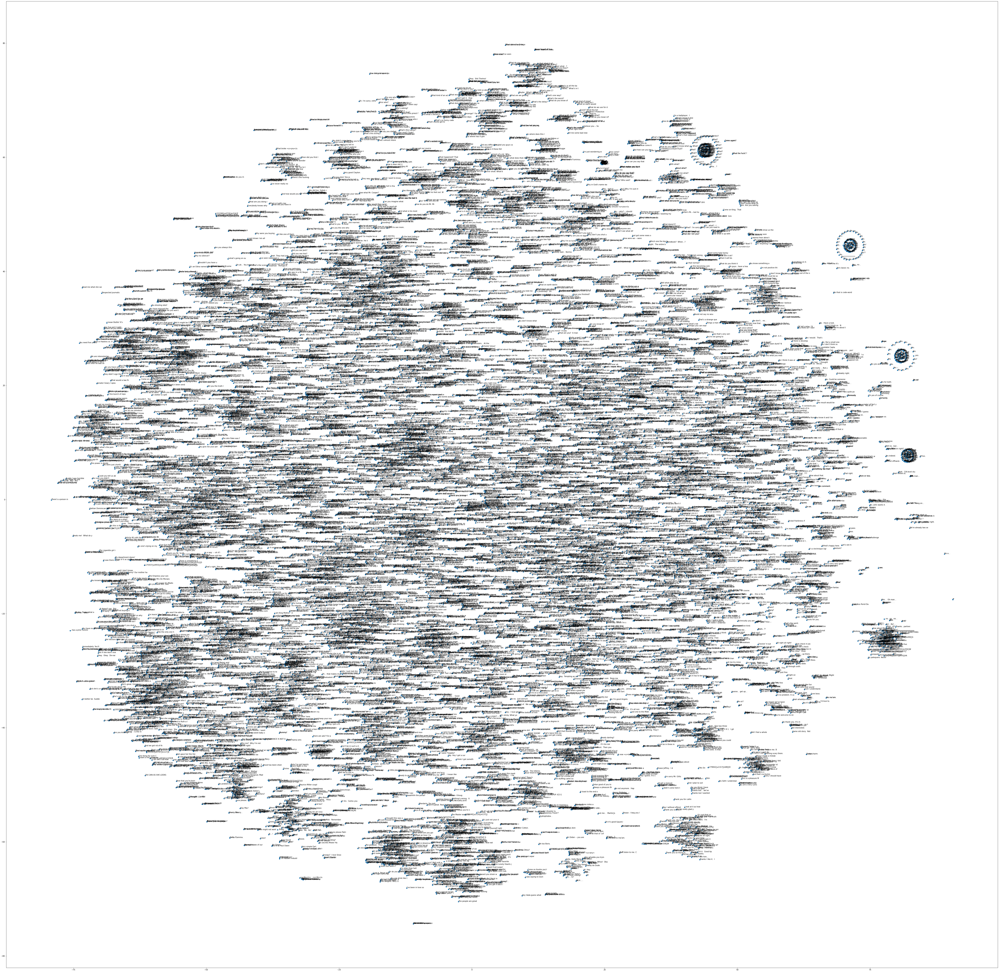

In [24]:
%matplotlib inline

import matplotlib.pyplot as plt

plt.figure(figsize=(100,100))
plt.scatter(x, y)

for i, txt in enumerate(texts):
    plt.annotate(txt[:20], (x[i], y[i]))

In [0]:
# text embeddings are stored in a file to call them and reuse them later
embedding_file = "sentence_embeddings_file.kv"
with open(embedding_file, "w") as o:
    o.write(f'{len(text_embeddings)} {len(text_embeddings[0])}\n')
    for text, embedding in zip(texts[:len(text_embeddings)], text_embeddings):
        text = re.sub("\s+", "_", text)
        string_embedding = " ".join([str(v) for v in embedding])
        o.write(f'{text} {string_embedding}\n')



In [0]:
%%capture
sentence_vectors = KeyedVectors.load_word2vec_format('sentence_embeddings_file.kv', binary=False) # 

In [13]:
# Get most similar sentences for a word
sentence_vectors.most_similar(positive=["Ok."])


/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



[('OK.', 1.0),
 ('...ok...', 1.0),
 ('O.K._O.K.', 0.9436497688293457),
 ('Okay._', 0.9149131178855896),
 ('Okay?', 0.9149131178855896),
 ('Okay.', 0.9149131178855896),
 ('Okay..._okay.', 0.8464376330375671),
 ('Okay_okay.', 0.8464376330375671),
 ('Alright.', 0.8339829444885254),
 ('..._Alright.', 0.8339829444885254)]

## Clustering (50%)

Afte

In [0]:
# Clustering method used- Agglomerative clustering with 2000 clusters using Euclidean as affinity
clusters = AgglomerativeClustering(n_clusters=2000, affinity="euclidean").fit_predict(text_embeddings)

In [16]:
# Printing the clusters for understanding the data representation of the clusters

df = pd.DataFrame({"text": texts, "cluster": clusters})
for cl in [500, 800, 1000, 1500, 1800]: 
    print(df.loc[df['cluster'] == cl])

                                                    text  cluster
2360   I'm your Goddamn wife. Once you vowed to cheri...      500
4047   I'm not going to strike you.  I am going to be...      500
6890   If I am your judge I cannot be your champion. ...      500
7471   That what happen--you lost you only daughter s...      500
9362   Shut up!  You only killed the bride's father -...      500
18745  Shut up! First you come waltzing into my life ...      500
19948  Well why not a milkmaid's daughter? No man of ...      500
                                                    text  cluster
828                         Smythe you've been drinking.      800
3995                               I think you're drunk.      800
4166                                          You sober?      800
6657                                 Brad you are drunk.      800
8669   Yeah... I think I understand...  You're drunk ...      800
10845                                What are you drunk?      800
12064     

### References:

- https://github.com/nlptown/nlp-notebooks/blob/master/Data%20exploration%20with%20sentence%20similarity.ipynb
- https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html
- https://plotly.com/python/line-and-scatter/
- https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html?highlight=sklearn.cluster#sklearn.cluster.AgglomerativeClustering
